<a href="https://colab.research.google.com/github/Saumitra-Shukla/Low-resolution-to-High-resolution-converter-GAN/blob/master/dataset0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [0]:
!ls

DIV2K_train_HR		DIV2K_valid_HR		drive
DIV2K_train_LR_bicubic	DIV2K_valid_LR_bicubic	x.pickle


In [0]:
! rm -rf x.pickle

In [0]:
!ls "/content/drive/My Drive/machine-learning/dataset"

In [0]:
import os,subprocess
path="/content/drive/My Drive/machine-learning/dataset"
for i in os.listdir(path):
  nn=os.path.join(path,i)
  print(nn)
  subprocess.call(['cp' ,nn ,i])
  subprocess.call(['unzip' ,i])
  subprocess.call(['rm' ,'-rf' ,i])

/content/drive/My Drive/machine-learning/dataset/DIV2K_train_HR.zip
/content/drive/My Drive/machine-learning/dataset/DIV2K_valid_HR.zip
/content/drive/My Drive/machine-learning/dataset/DIV2K_train_LR_bicubic_X4.zip
/content/drive/My Drive/machine-learning/dataset/DIV2K_valid_LR_bicubic_X4.zip


In [0]:
!ls

DIV2K_train_HR		DIV2K_valid_HR		drive
DIV2K_train_LR_bicubic	DIV2K_valid_LR_bicubic


In [0]:
!pip install tf-nightly-gpu-2.0-preview

In [0]:
import numpy as np
import matplotlib.pyplot as plt
import os
import cv2
from keras.preprocessing.image import ImageDataGenerator as idg

Using TensorFlow backend.


In [0]:
gen=idg(rotation_range=10, width_shift_range=0.1, height_shift_range=0.1,
                                              shear_range=0.1, zoom_range=0.1,
                                             channel_shift_range=10, horizontal_flip=True, vertical_flip=True)

In [0]:
def plots(ims,figsize=(12,6),rows=1,interp=False,titles=None):
  if type(ims[0]) is np.ndarray:
    ims=np.array(ims).astype(np.uint8)
    if (ims.shape[-1]!=3):
      ims=ims.transpose((0,2,3,1))
  f=plt.figure(figsize=figsize)
  cols=len(ims)//rows if len(ims) % 2 == 0 else len(ims)//rows +1
  for i in range(len(ims)):
    sp=f.add_subplot(rows,cols,i+1)
    sp.axis('Off')
    if titles is not None:
      sp.set_title(titles[i],fontsize=16)
    plt.imshow(ims[i], interpolation=None if interp else 'none')

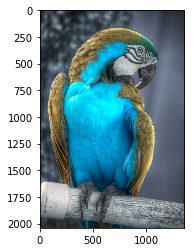

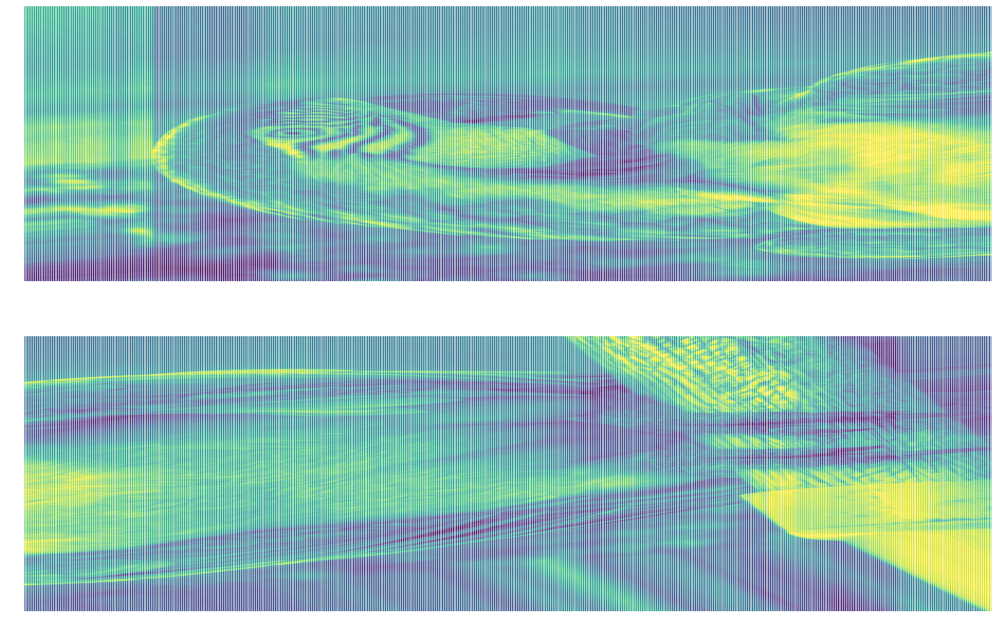

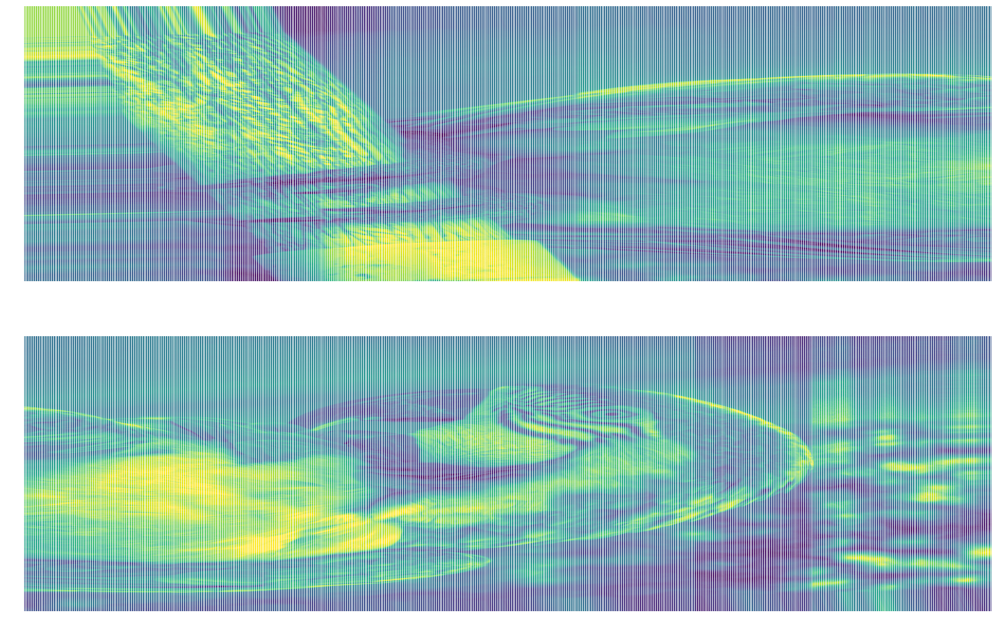

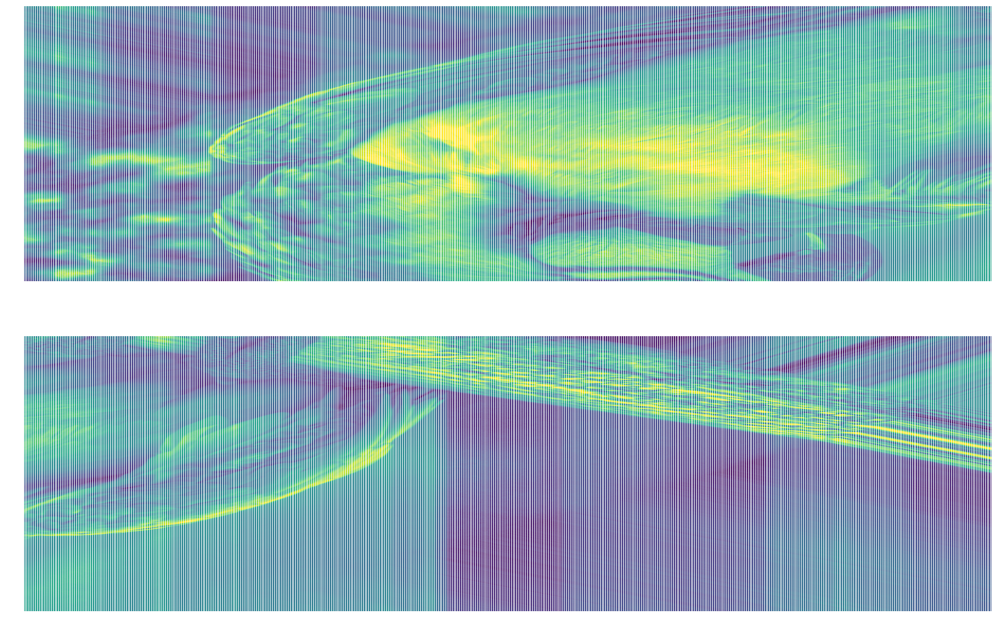

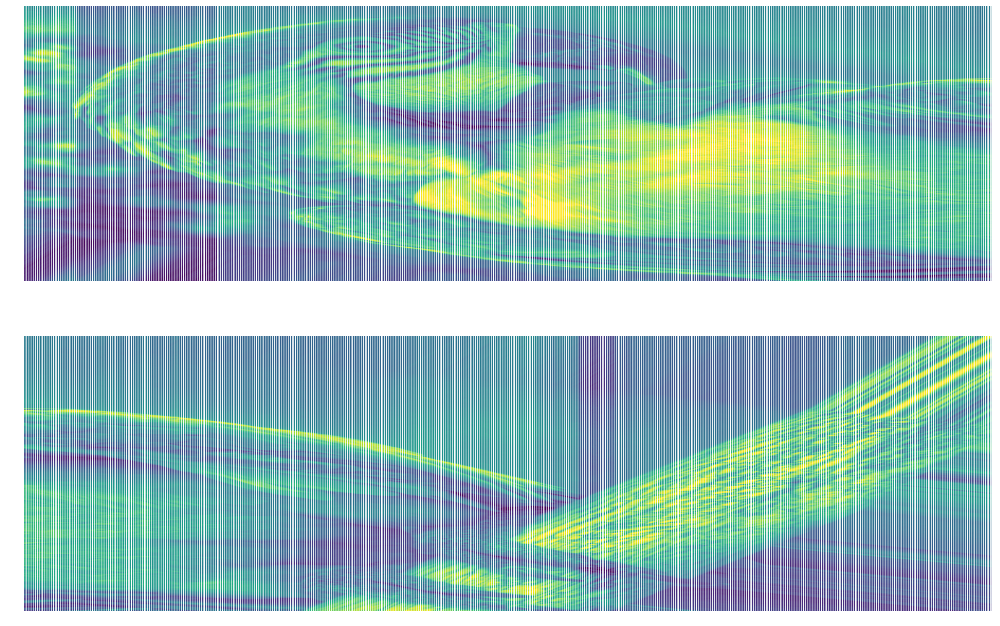

...

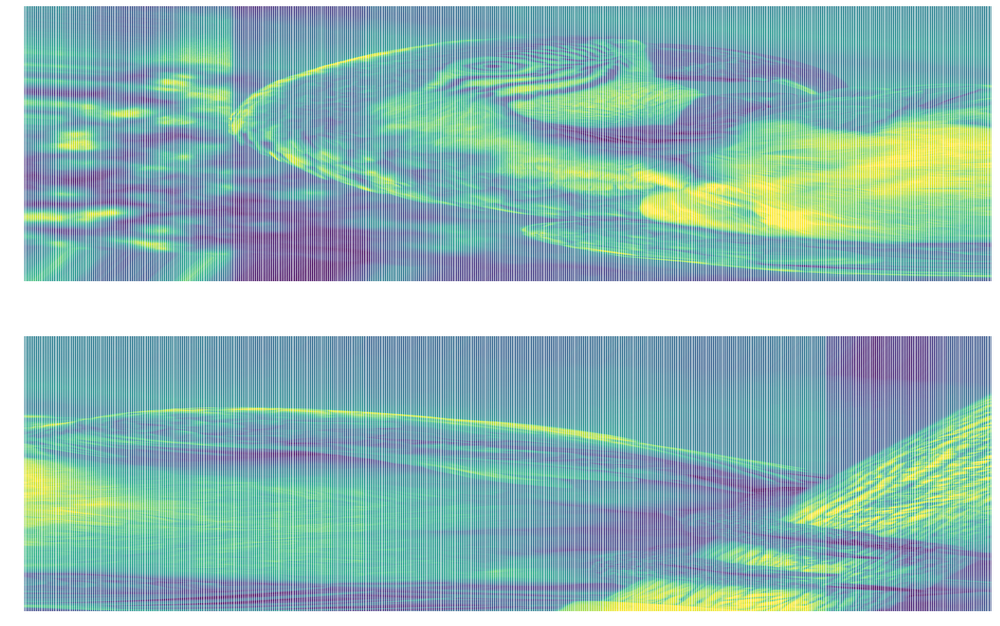

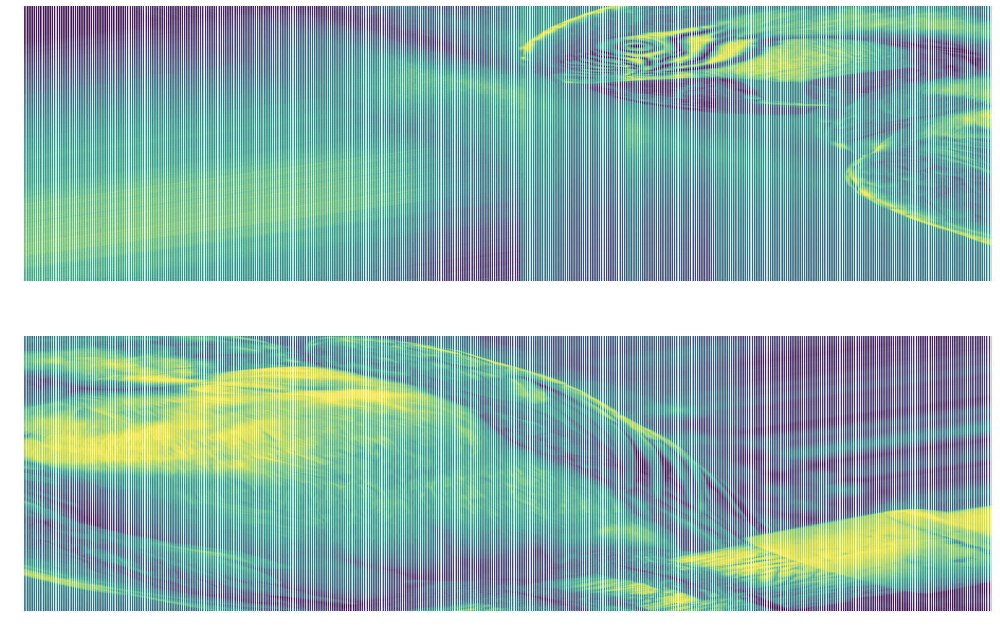

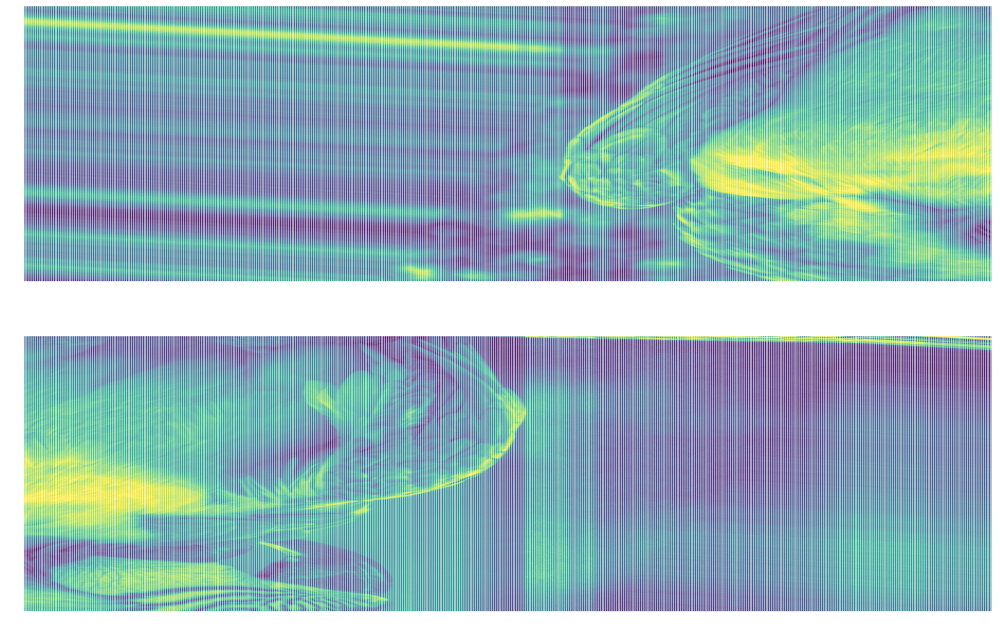

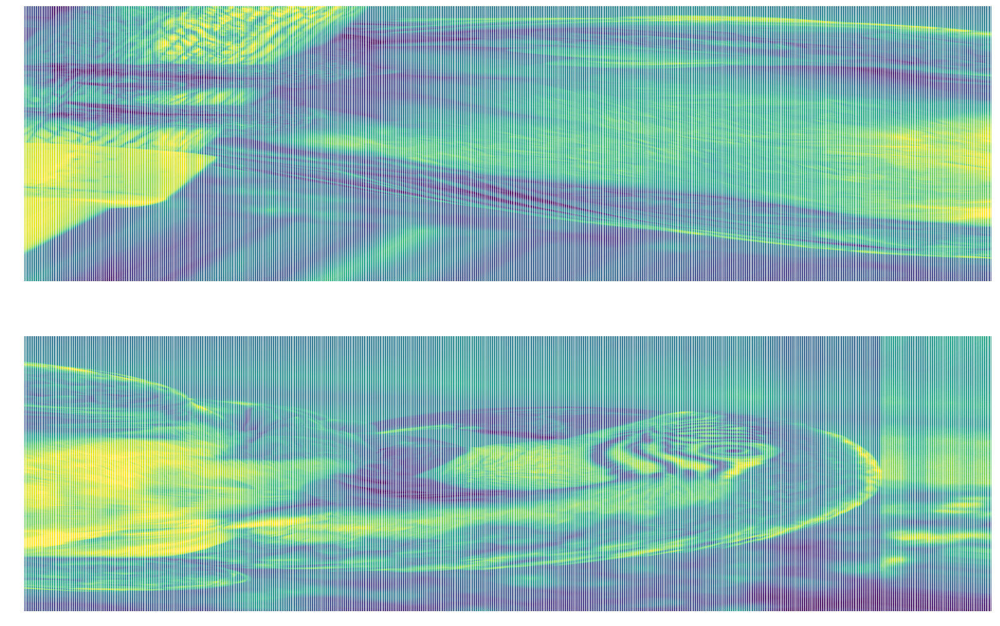

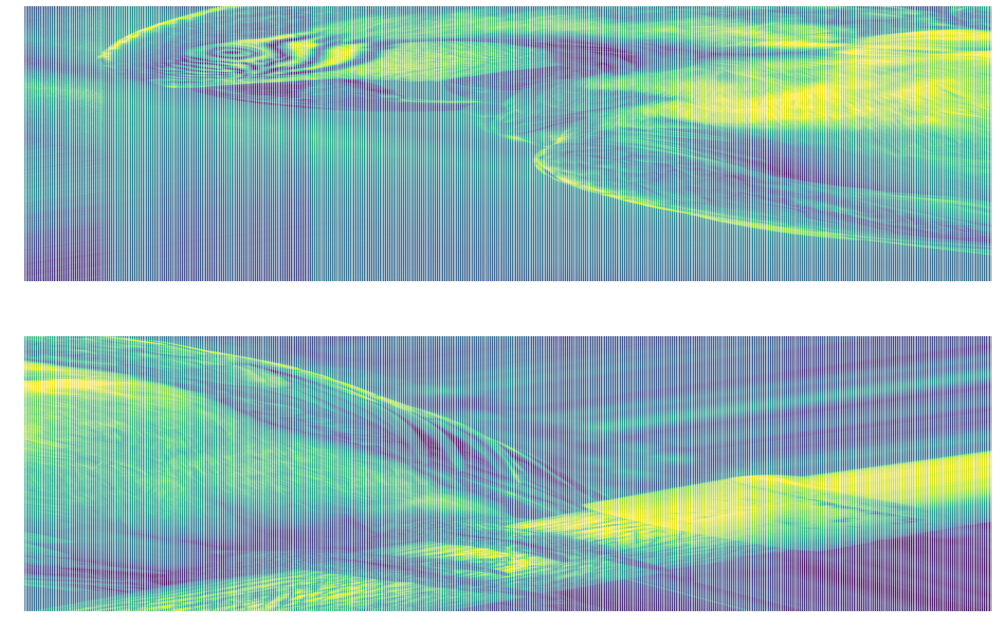

In [0]:
categ=['HR','LR_bicubic']
fl_str='DIV2K_train_'
for c in categ:
  fl_path=fl_str+c
  for img in os.listdir(fl_path):
    try:
      img_path=os.path.join(fl_path,img)
      img_array=cv2.imread(img_path)
      plt.imshow(img_array)
      plt.show()
      aug_iter=gen.flow(np.expand_dims(img_array,0))
      for i in range(10):
      #aug_img=next(aug_iter)
        plots(next(aug_iter)[0].astype(np.uint8),figsize=(28,18),rows=2)
        plt.show()
    except Exception as e:
      continue

    break 
  break

In [0]:
categ=['HR','LR_bicubic']
training_data=[]
img_size=1500
fl_str='DIV2K_train_'
for c in categ:
  fl_path=fl_str+c
  i=categ.index(c)
  for img in os.listdir(fl_path):
    try:
      img_path=os.path.join(fl_path,img)
      img_array=cv2.imread(img_path)
      img_array=cv2.resize(img_array,(img_size,img_size))
      #aug_iter=gen.flow(np.expand_dims(img_array,0))
      training_data.append([img_array,i])
      '''
      for i in range(10):
      #aug_img=next(aug_iter)
        #.astype(np.uint8)
        training_data.append([next(aug_iter)[0],i])
        
      #training_data.append([img_array,i])
      '''
    except Exception as e:
      pass

In [0]:
print(len(training_data))

800


In [0]:
x=[]
y=[]
for features,label in training_data:
    x.append(features)
    y.append(label)
    
#x=np.array(x).reshape(-1,100,100,1)

import pickle
pickle_out= open("x.pickle", "wb")
pickle.dump(x,pickle_out)
pickle_out.close()

pickle_out= open("y.pickle", "wb")
pickle.dump(y,pickle_out)
pickle_out.close()